In [5]:
import numpy as np
from astropy.io import fits
from glob import glob
import matplotlib.pyplot as plt
import stdatamodels.jwst.datamodels as dm

/tmp/ipykernel_2085/1274847910.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20,4))


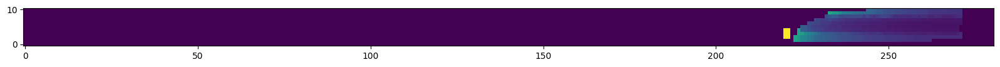

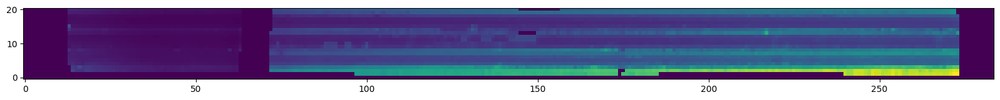

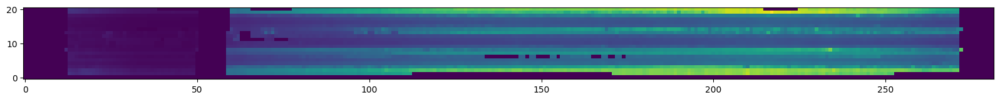

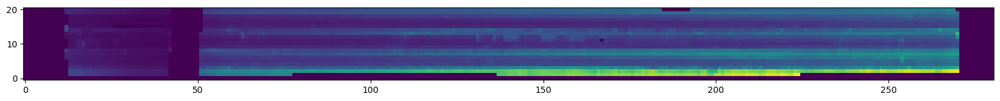

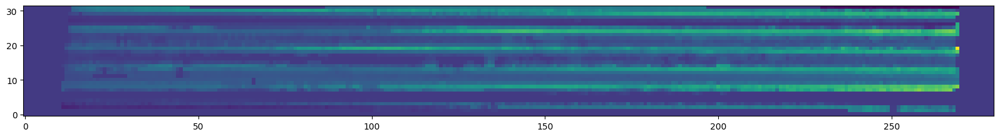

...

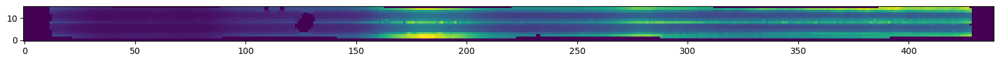

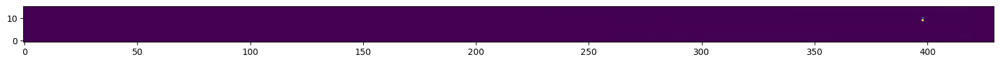

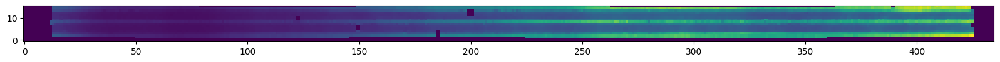

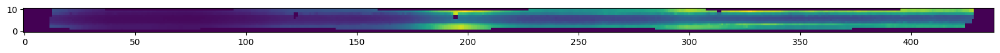

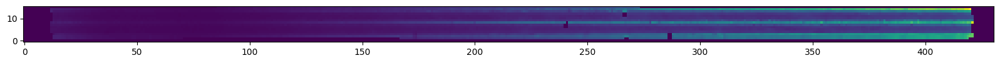

In [10]:
working_dir = "../mastDownload/JWST/CEERS-NIRSPEC-P10-PRISM-MSATA/Final/"

files = glob(working_dir+"*")
for file in files:
    if "_s2d.fits" in file:
        with fits.open(file) as hdul:
            hdu = hdul["SCI"]
            plt.figure(figsize=(20,4))
            plt.imshow(hdu.data,origin="lower")
            plt.savefig(file.replace(".fits",".png"),dpi=300)

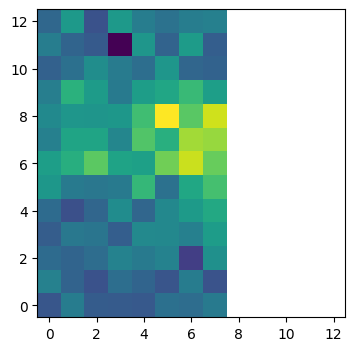

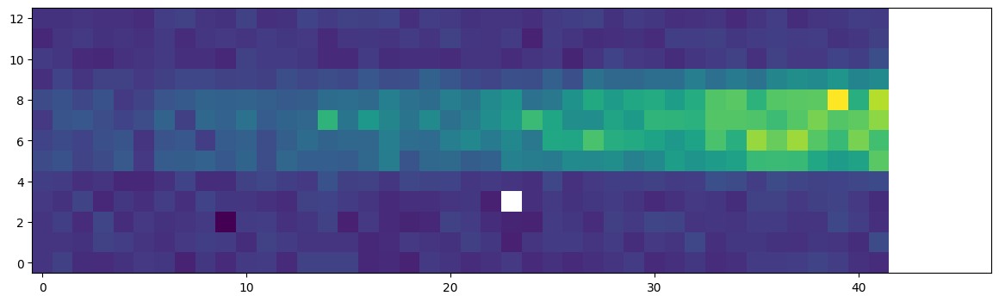

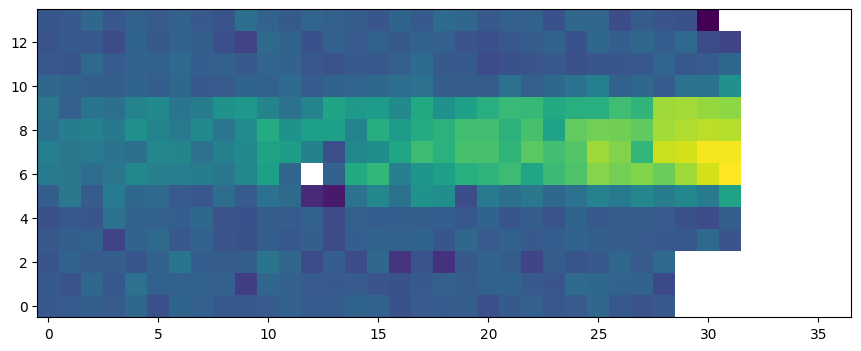

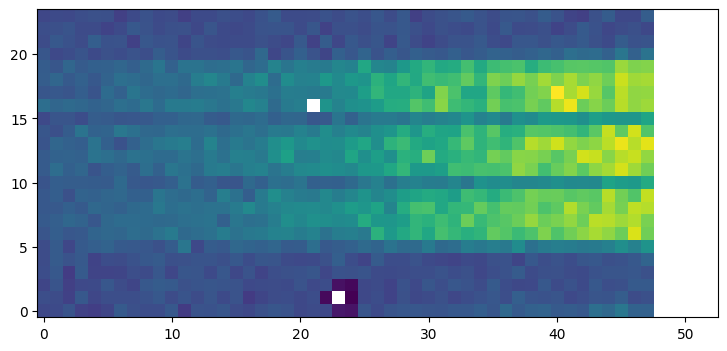

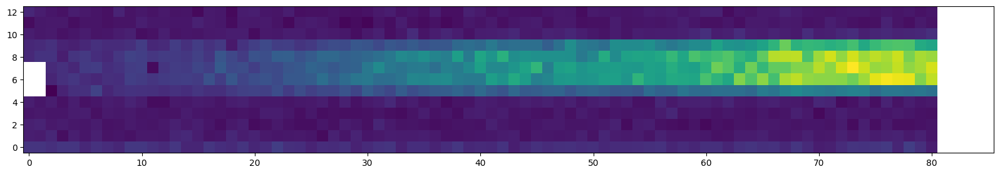

...

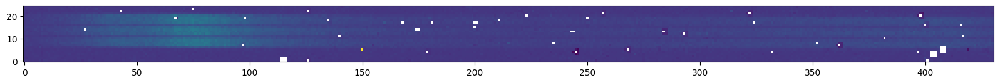

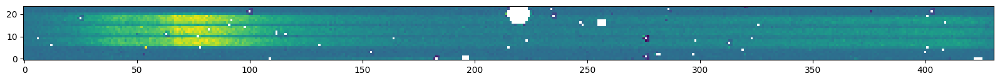

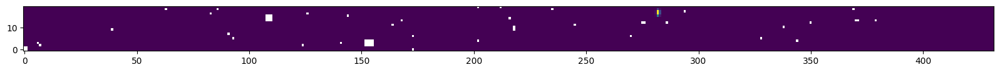

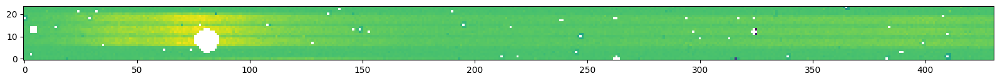

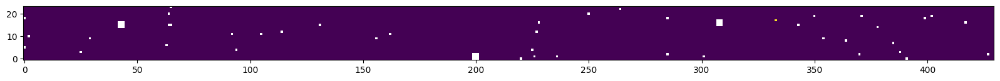

In [12]:
with fits.open("../TestStage2/jw01345063001_03101_00001_nrs1_srctype.fits") as hdul:
    for hdu in hdul:
        if hdu.name == "SCI":
            data = hdu.data
            plt.figure(figsize=(20,4))
            plt.imshow(data,origin="lower")
            plt.show()

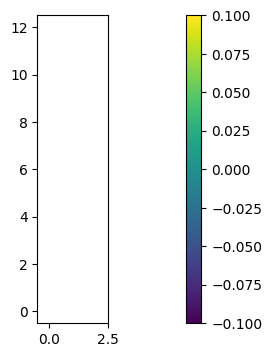

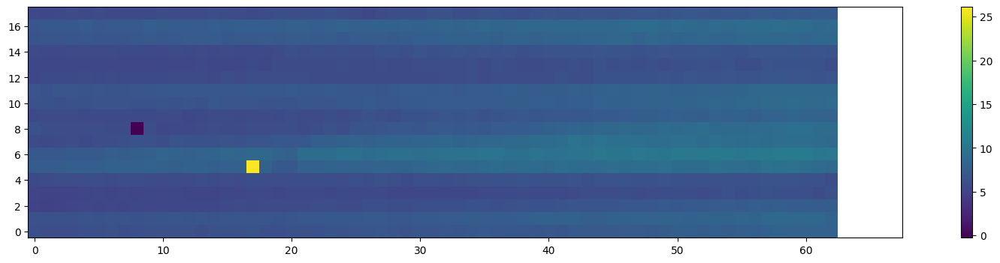

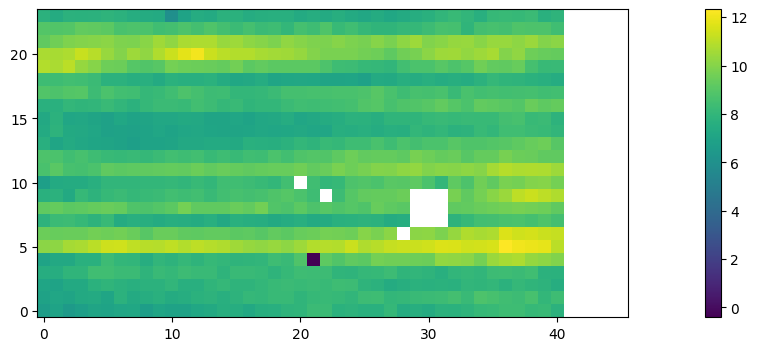

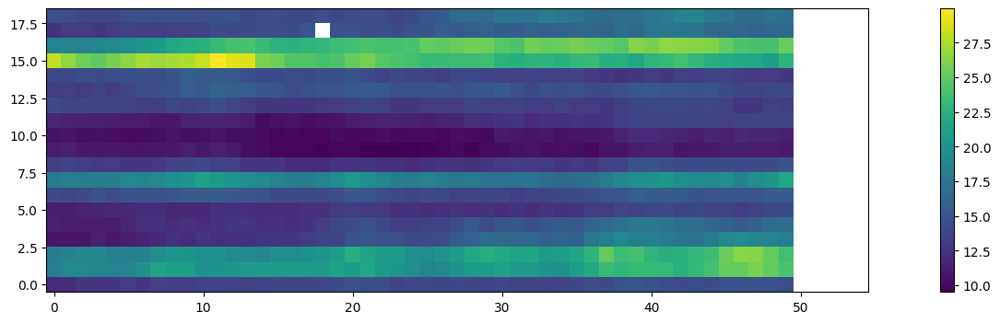

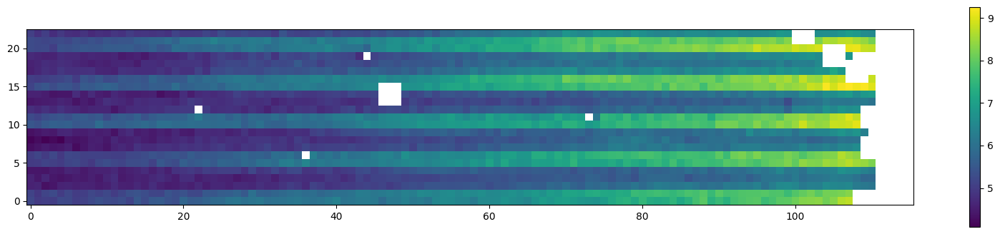

...

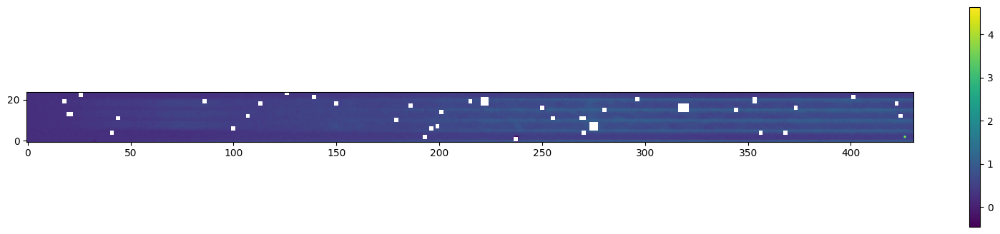

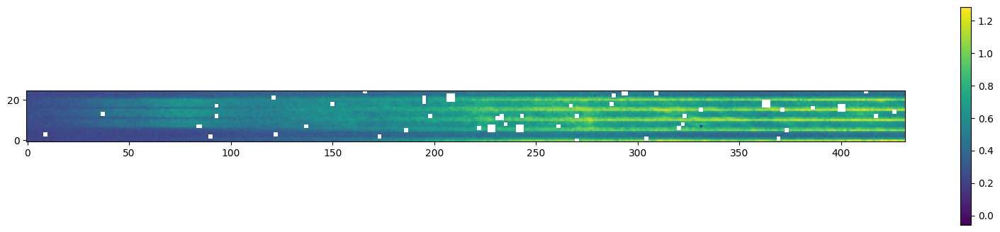

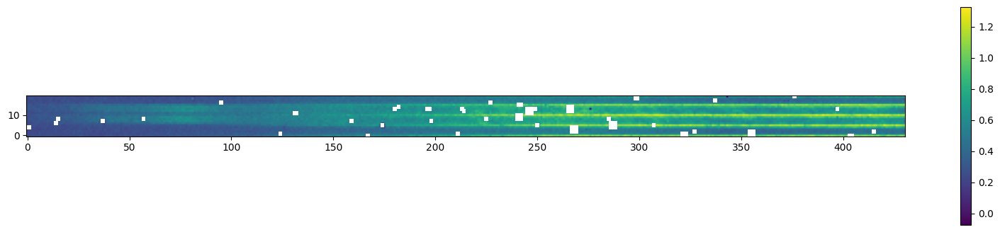

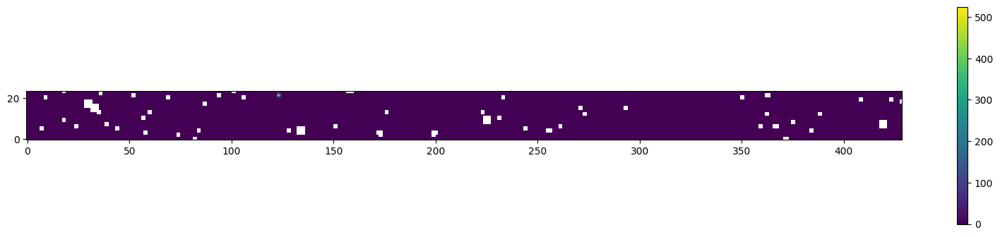

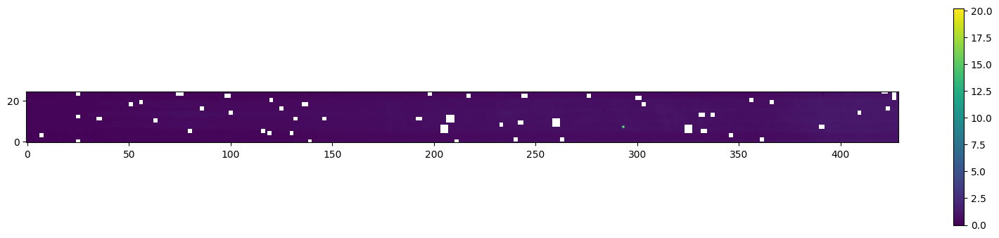

In [22]:
with fits.open("../TestStage2/jw01345072001_03101_00001_nrs1_srctype.fits") as hdul:
    for hdu in hdul:
        if hdu.name == "SCI":
            data = hdu.data
            plt.figure(figsize=(20,4))
            plt.imshow(data,origin="lower")
            plt.colorbar()
            plt.show()
            

In [8]:
exp = dm.open("../TestStage2/jw01345072001_03101_00001_nrs1_srctype.fits")
print(exp)

<MultiSlitModel from jw01345072001_03101_00001_nrs1_srctype.fits>


In [9]:
with fits.open("../TestStage2/jw01345072001_03101_00001_nrs1_srctype.fits") as hdul:
    data = hdul[1].data
    
X,Y = np.indices(data.shape)
ra, dec, lam = exp.meta.wcs(X, Y)

plt.figure()
plt.imshow(ra)
plt.show()

print(ra, dec, lam)

AttributeError: No attribute 'wcs'

In [26]:
with fits.open("../TestStage2/jw01345072001_03101_00001_nrs1_srctype.fits") as hdul:
    data = hdul[1].data
    hdul[1].header.append("", end=True)
    hdul[1].header.append("", end=True)
    hdul[1].header.append("BB_DONE", end=True)
    hdul[1].header["BB_DONE"] = True
    hdul[1].header["BB_TEST"] = (12,"test")
    hdul[1].header["BB_1111"] = 1234
    
    hdul[1].header["BB_1111"] = 1234
    
    hdul.writeto("test_hdr_overwrite.fits",overwrite=True)